## Social network analysis

In [1]:
import matplotlib.pyplot as plt
import networkx as nx
import operator
from collections import Counter

Напишем функцию, которая составляла бы список кортежей для последующей передачи списка в networkx:

In [2]:
def edges_generator(file):
    with open(file, 'r', encoding="UTF-8") as f:
        csv = f.read()
    line_list = csv.split('\n')
    edges = []
    for line in line_list:
        line_tuple = (line.split(';')[0], line.split(';')[1])
        edges.append(line_tuple)
    return edges

Составим список друзей (вершин):

In [3]:
with open('id-names.csv', 'r', encoding="UTF-8") as f:
    csv = f.read()
line_list = csv.split('\n')
friends = []
for line in line_list:
    line_tuple = (line.split(';')[1])
    friends.append(line_tuple)

Составляем список вершин со связями:

In [4]:
with open('labels.csv', 'r', encoding="UTF-8") as f:
    csv = f.read()
line_list = csv.split('\n')
weighted_edges = []
for line in line_list:
    line_tuple = (line.split(';')[0])
    line_tuple2 = (line.split(';')[1])
    weighted_edges.append(line_tuple)
    weighted_edges.append(line_tuple2)
w = set(weighted_edges)
len(w)

141

Итак, всего у нас 141 друг, который дружит с кем-то еще. Теперь находим вершины, у которых нет связей, чтобы тоже добавить их в граф:

In [5]:
nf = []
for i in friends:
    if i not in w:
        nf.append(i)

Составим общий список вершин (друзей) - которые дружат между собой или которые дружат только со мной:

In [6]:
nodes = list(w)+nf

Составим список кортежей для составления графа при помощи написанной ранее функции:

In [8]:
edges = edges_generator('labels.csv')

Создадим граф, добавив туда все вершини и все ребра:

In [9]:
G = nx.Graph()
G.add_nodes_from(nodes)
G.add_edges_from(edges)

Исследуем граф - вычислим некоторые показатели:

In [10]:
print('Кол-во вершин', '-', G.number_of_nodes())
print('Кол-во ребер', '-', G.number_of_edges())
print('Плотность - ', nx.density(G))

Кол-во вершин - 157
Кол-во ребер - 1006
Плотность -  0.08214927323207578


In [11]:
nodes_d = []
for node in G.nodes():
    dg = G.degree(node)
    nodes_d.append(dg)
print('Средняя степень узла - ', sum(nodes_d)/157)

Средняя степень узла -  12.815286624203821


In [ ]:
Визуализируем граф:

In [12]:
plt.figure(num=1, figsize=(300,250))
nx.draw(G,
        node_color='cyan',
        node_size=10,
        with_labels=True,
        font_size=50,
        font_family='DejaVu Sans')
plt.savefig('graph_no_circles.svg')
plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


Найдем показатель центральности для каждой вершины и визуализируем граф с учетом показателя: размер вершины пропорционален ее degree centrality:

In [13]:
nodes_degree = {}
deg = nx.degree_centrality(G)
for nodeid in sorted(deg, key=deg.get, reverse=True):
    nodes_degree[nodeid] = deg[nodeid] * 750000

In [14]:
node_d = {}
for i in nodes:
    node_d[i] = nodes_degree[i]

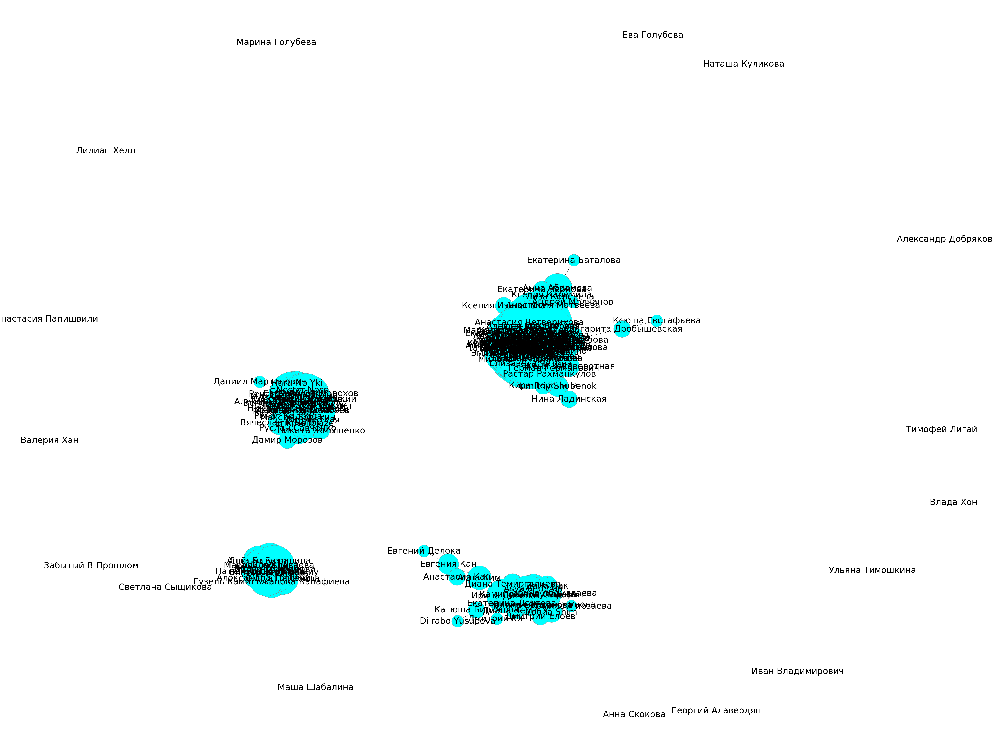

In [15]:
pos = nx.spring_layout(G)
plt.figure(figsize=(80,60))

options = {
    "font_size": 50,
    "node_size": list(node_d.values()),
    "node_color": "cyan",
    "edgecolors": "grey",
    "linewidths": 1,
    "width": 1,
    "with_labels": True  
}
nx.draw(G, pos, **options)
plt.savefig('graph.png')
plt.show()

Видим, что есть ярко выраженные 4 связные компоненты. Визуализируем их отдельно.

In [16]:
G = nx.Graph()
G.add_nodes_from(list(w))
G.add_edges_from(edges)
graphs = list(nx.connected_component_subgraphs(G))

In [17]:
g1, g2, g3, g4 = graphs

In [18]:
nodes_degree = {}
deg = nx.degree_centrality(G)
for nodeid in sorted(deg, key=deg.get, reverse=True):
    nodes_degree[nodeid] = deg[nodeid] * 100000

Компонента 1:

In [19]:
g1_d = {}
for i in list(g1):
    g1_d[i] = nodes_degree[i]

In [20]:
pos = nx.spring_layout(g1)
plt.figure(figsize=(200,170))

options = {
    "font_size": 50,
    "node_size": list(g1_d.values()),
    "node_color": "cyan",
    "edgecolors": "grey",
    "linewidths": 1,
    "width": 1,
    "with_labels": True  
}
nx.draw(g1, pos, **options)
plt.savefig('g1.png')
plt.show()

In [21]:
print('Плотность - ', nx.density(g1))

Плотность -  0.2648667122351333


Компонента 2:

In [22]:
g2_d = {}
for i in list(g2):
    g2_d[i] = nodes_degree[i]

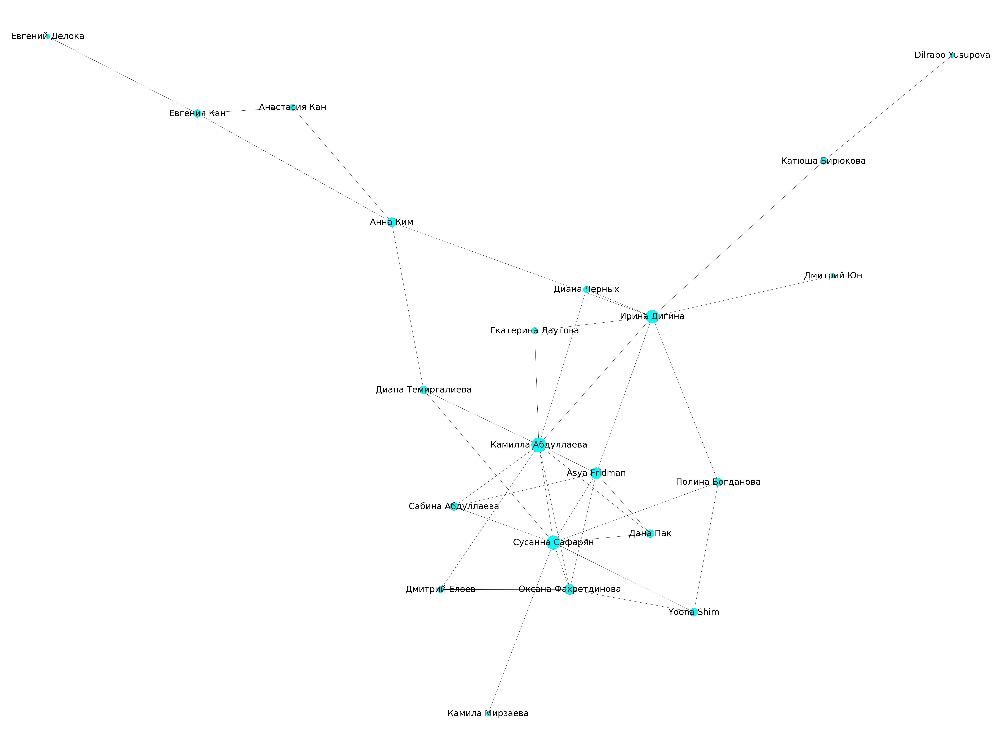

In [23]:
pos = nx.spring_layout(g2)
plt.figure(figsize=(80,60))

options = {
    "font_size": 50,
    "node_size": list(g2_d.values()),
    "node_color": "cyan",
    "edgecolors": "grey",
    "linewidths": 1,
    "width": 1,
    "with_labels": True  
}
nx.draw(g2, pos, **options)
plt.savefig('g2.png')
plt.show()

In [24]:
print('Плотность - ', nx.density(g2))

Плотность -  0.1761904761904762


Компонента 3:

In [25]:
g3_d = {}
for i in list(g3):
    g3_d[i] = nodes_degree[i]

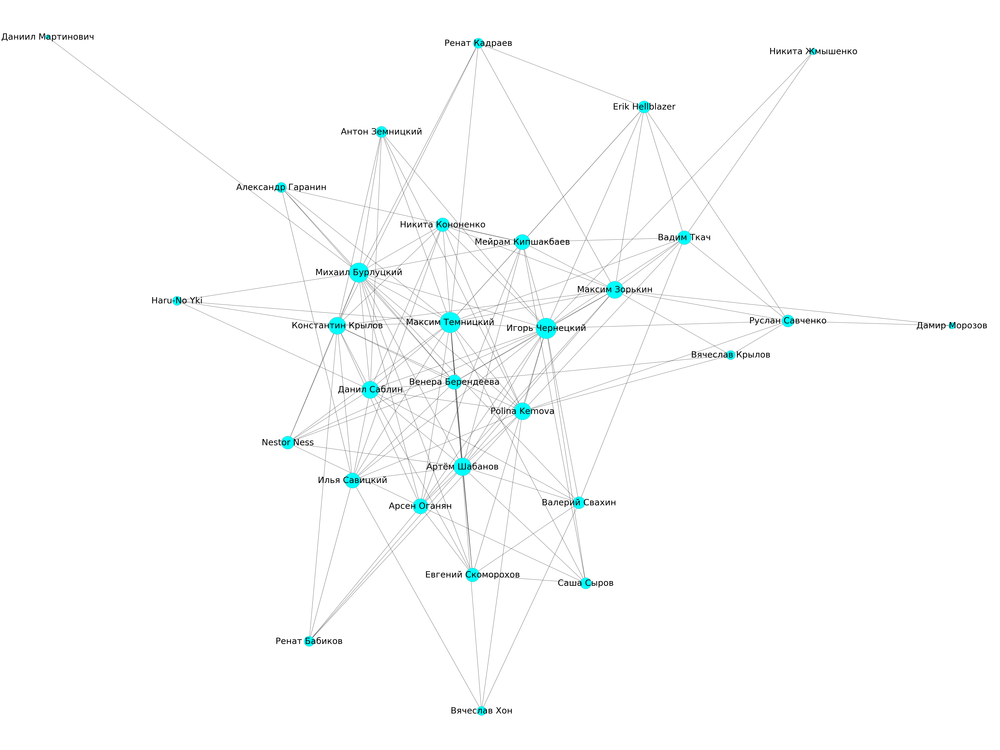

In [26]:
pos = nx.spring_layout(g3)
plt.figure(figsize=(80,60))

options = {
    "font_size": 50,
    "node_size": list(g3_d.values()),
    "node_color": "cyan",
    "edgecolors": "grey",
    "linewidths": 1,
    "width": 1,
    "with_labels": True  
}
nx.draw(g3, pos, **options)
plt.savefig('g3.png')
plt.show()

In [27]:
print('Плотность - ', nx.density(g3))

Плотность -  0.31264367816091954


Компонента 4:

In [28]:
g4_d = {}
for i in list(g4):
    g4_d[i] = nodes_degree[i]

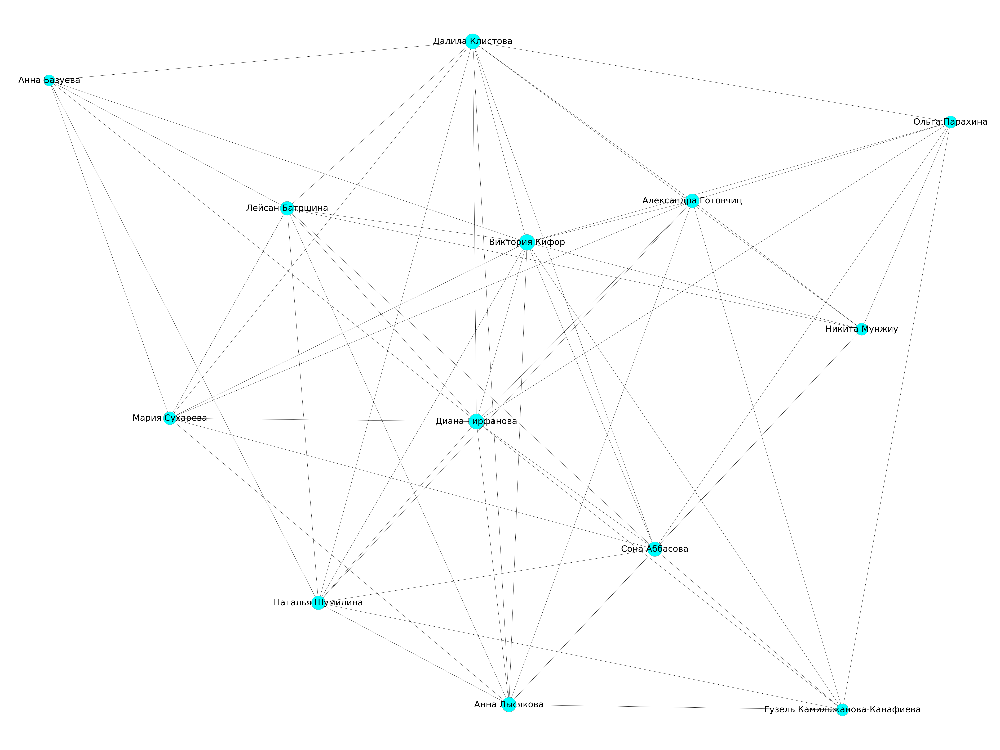

In [29]:
pos = nx.spring_layout(g4)
plt.figure(figsize=(80,60))

options = {
    "font_size": 50,
    "node_size": list(g4_d.values()),
    "node_color": "cyan",
    "edgecolors": "grey",
    "linewidths": 1,
    "width": 1,
    "with_labels": True  
}
nx.draw(g4, pos, **options)
plt.savefig('g4.png')
plt.show()

In [30]:
print('Плотность - ', nx.density(g4))

Плотность -  0.7435897435897436


In [ ]:
Видим, что наиболее плотная компонента - третья, тогда как самая многочисленная (с наибольшим количество вершин) - первая.

Визуализируем на графике топ-20 вершин с самым высоким показателем центральности:

In [31]:
x = list(nodes_degree.keys())[:20]
y = [i/100000 for i in list(nodes_degree.values())[:20]]

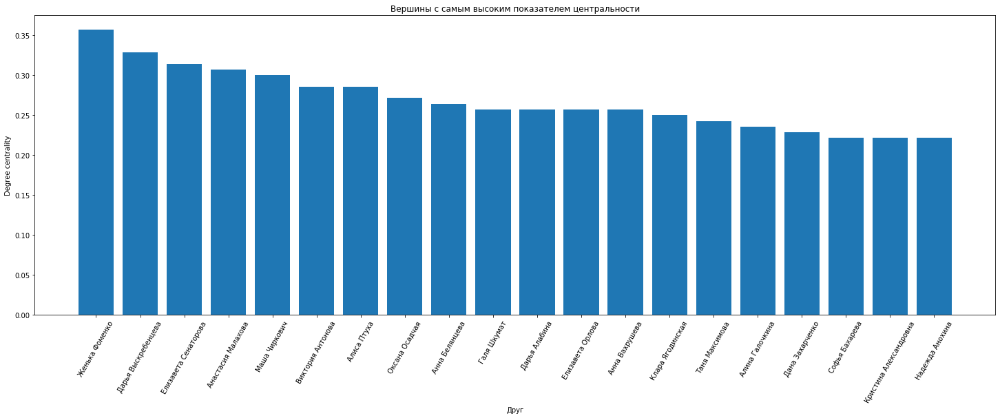

In [32]:
plt.figure(1, figsize=(25, 8))
plt.title('Вершины с самым высоким показателем центральности')
plt.ylabel('Degree centrality')
plt.xlabel('Друг')
plt.xticks(rotation=60)
plt.bar(x, y)
plt.savefig('top20friends.png')
plt.show()

Покажем распределение степеней общего графа:

In [38]:
G = nx.Graph()
G.add_nodes_from(nodes)
G.add_edges_from(edges)

In [39]:
nodes_degree = {}
deg = nx.degree_centrality(G)
for nodeid in sorted(deg, key=deg.get, reverse=True):
    nodes_degree[nodeid] = deg[nodeid]

In [40]:
node_d = {}
for i in nodes:
    node_d[i] = nodes_degree[i]

In [41]:
degree_distribution = dict(Counter(nodes_d))

In [42]:
x = list(degree_distribution.keys())
y = list(degree_distribution.values())

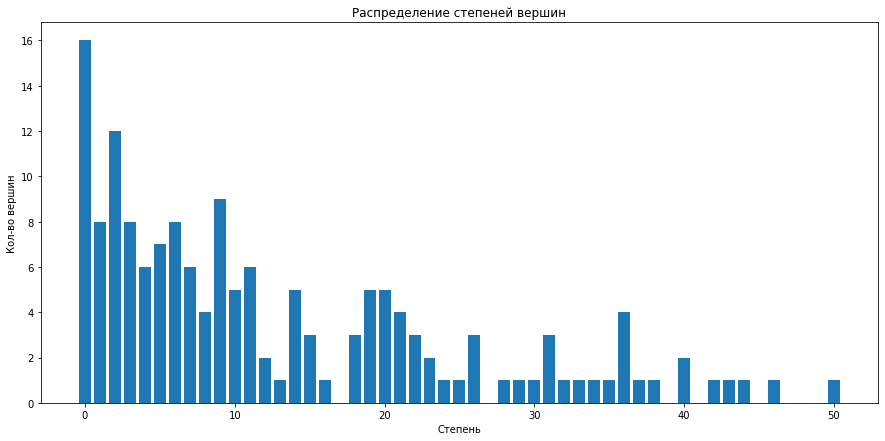

In [43]:
plt.figure(1, figsize=(15, 7))
plt.title('Распределение степеней вершин')
plt.ylabel('Кол-во вершин')
plt.xlabel('Степень')
plt.bar(x, y)
plt.show()

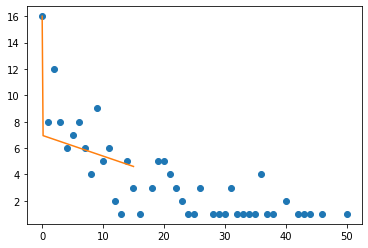

In [45]:
from scipy import optimize
import numpy as np

def piecewise_linear(x, x0, y0, k1, k2):
    return np.piecewise(x, [x < x0], [lambda x:k1*x + y0-k1*x0, lambda x:k2*x + y0-k2*x0])

p , e = optimize.curve_fit(piecewise_linear, x, y)
xd = np.linspace(0, 15, 100)
plt.plot(x, y, "o")
plt.plot(xd, piecewise_linear(xd, *p))

Log-log scale для этих значений:

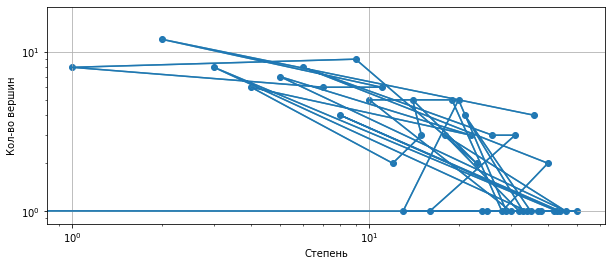

In [47]:
_, ax = plt.subplots(figsize=(10,4))
ax.plot(x, y, color='#539caf', alpha=1)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xticks(x)
ax.set_yticks(y)
plt.xscale('log')
plt.yscale('log')
plt.ylabel('Кол-во вершин')
plt.xlabel('Степень')
plt.scatter(x, y)
plt.plot(x, y)
plt.grid(True)
plt.show()

### По итогам анализа графа выяснилось следующее:

1. Подавляющее большинство вершин имеют связи, но 16 ни с кем не связаны.
2. Граф в явном виде делится на 4 связные компоненты, как и предполагалось. Для поиска сообществ не потребовались дополнительные инструменты.
3. Плотность третьей компоненты самая большая - при этом она больше, чем плотность в основном графе.
4. Топ-20 вершин с самым высоким показателем центральности все находятся в первой компоненте (в которой наибольшее количество вершин).